# Physics in Lenia, the artificial life form


## Abstract

John H. Conway's Game of Life, along with cellular automata in the broader category of Life-like CA, operate discretely. Recent advancements in CA, such as [*Lenia*[1]](https://arxiv.org/abs/2005.03742), have garnered significant attention due to their highly self-organizing and continuous lifeforms. This notebook presents an exploration of various intriguing properties of Lenia. In Part I, we observe that as the size of the world increases, the fast Fourier transform provides a noticeable speedup compared to the original convolution updates in Lenia. The choice of Python packages also influences the outcome, with scipy's built-in FFT function exhibiting the fastest computation time. Moreover, certain grid sizes may result in more errors or fluctuations than others. Not surprisingly, the distinction between CPU and GPU computation is negligible since Lenia's iterations are generally not computationally intensive. However, notable changes become apparent when introducing laws of physics, such as conservation of mass and energy (Part II). In Part III, through an analysis of energy gradient descent, we deduce that [*Runge-Kutt*](https://en.wikipedia.org/wiki/Runge%E2%80%93Kutta_methods) methods of order 1 (Euler) and order 4 outperform order 2 for PDE systems like Lenia. Furthermore, the entropy of the field within a given window size aligns sensibly with these implemented laws. Subsequently, we observe interference patterns as Lenia evolves upon entering the quantum realm. Finally, experimental evidence reveals that each creature in Lenia only exists within a limited range of update step sizes, while the use of floating-point numbers has minimal impact on the system.

### Imports & preparations

In [1]:
%matplotlib inline  
import os, glob
import numpy as np
from collections import namedtuple
import matplotlib.pylab as plt
import matplotlib.animation
from functools import partial

# optional: make cells display wider
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

# import packages from other folders
from utils.simulation import Simulator, show_videofile
from utils.helper import load_from_json
from utils.helper import soft_clip as sc
from utils.Kernel import Kernel
from utils.Growth_fn import Growth_fn
from utils.Cells import Cells
from utils.lenia import lenia_origin_diagram, lenia_extended_diagram, lenia_multi_channel_diagram, lenia_coex_diagram, lenia_mass_diagram
from flow_lenia.flow import lenia_mass_flow
from utils.librarian import Librarian
from utils.entropy import *

# prepare demonstration files
Params = namedtuple('Params', 'R, mu, sigma, size, dt, cells, b')
Params_f = namedtuple('Params_f', 'mu_k sigma_k w_k mu_g sigma_g c_rep dt')
orbium = load_from_json('./zoo/orbium.json')
orbium_params = Params(R=orbium["R"], mu=orbium["m"], sigma=orbium["s"], size=1<<6, dt=orbium["dt"], cells=orbium["cells"], b=orbium["b"])
rotator = load_from_json('./zoo/rotator.json')
geminium = load_from_json('./zoo/geminium.json')
geminium_params = Params(R=geminium["R"], mu=geminium["m"], sigma=geminium["s"], size=1<<6, dt=geminium["dt"], cells=geminium["cells"], b=geminium["b"])
fish = load_from_json('./zoo/fish.json')
aquarium = load_from_json('./zoo/aquarium.json')
emitter = load_from_json('./zoo/emitter.json')
pacman = load_from_json('./zoo/pacman.json')
# mass flow preparation
Coex_Params = [Params(R=orbium["R"], mu=orbium["m"], sigma=orbium["s"], size=1<<8, dt=orbium["dt"], cells=orbium["cells"], b=orbium["b"]), Params(R=rotator["R"], mu=rotator["m"], sigma=rotator["s"], size=1<<8, dt=rotator["dt"], cells=rotator["cells"], b=rotator["b"])]


Reading JSON file ./zoo/orbium.json ...
Completed !
Reading JSON file ./zoo/rotator.json ...
Completed !
Reading JSON file ./zoo/geminium.json ...
Completed !
Reading JSON file ./zoo/fish.json ...
Completed !
Reading JSON file ./zoo/aquarium.json ...
Completed !
Reading JSON file ./zoo/emitter.json ...
Completed !
Reading JSON file ./zoo/pacman.json ...
Completed !


### Utils for visualization

In [2]:
# helper function for direct simulation in notebook
def figure_world(A, titles, cmap='gray'):
    global img

    if titles == None:
        titles = ["Title!"]

    fig = plt.figure()
    # invert cmap
    A = 1-A
    img = plt.imshow(A, cmap=cmap, interpolation="nearest", vmin=0, vmax=1)
    plt.title(titles)
    plt.close()
    return fig

# Introduction

Cellular automata (CA) operate by applying a set of rules to a discrete grid of cells. At each timestep, the values of these cells are updated based on their [*Moore neighborhood*](https://en.wikipedia.org/wiki/Moore_neighborhood). This concept was introduced by John von Neumann and Stanislaw Ulam in 1951 and 1962, respectively. CA systems are generally deterministic, and their simulation outcomes heavily rely on the initial state of the grid. However, CA can serve as proofs of Turing completeness, demonstrating their potential for universal computation. By extending these models to a continuous domain, it becomes possible to model various biological phenomena.

One of the most well-known CA is Conway's Game of Life (GoL), in which cell values are updated based on their neighboring cells. Despite its simplicity, GoL has fascinated researchers and enthusiasts with its diverse range of complex behaviors. To explore more intriguing patterns, the concept of a continuous domain was introduced. For instance, [*Primordia*](https://chakazul.github.io/Primordia/Primordia.html) uses normalized values instead of binary states, resulting in a continuous state. To construct long-range soliton-like lifeforms, Bert Chan [*(Chain, 2020)*[2]](https://arxiv.org/pdf/1812.05433.pdf) proposed Lenia. In the first part of this report, we will introduce different forms of Lenia and compare their update algorithms using approaches such as [*convolution*](https://en.wikipedia.org/wiki/Convolution) and [*fast fourier transformation*](https://en.wikipedia.org/wiki/Fast_Fourier_transform). We will conduct error analysis on multiple data runs and provide interpretations regarding the update rules. Additionally, we will investigate the speedup achieved on different hardware, namely CPU and GPU. Inspired by [*Flow lenia*[3]](https://sites.google.com/view/flowlenia/), we will proceed to study the physics law of mass conservation in Lenia, making the simulation more physical. We will compare the entropy, within a given window size, before and after enforcing the conservation law and perform similar error analysis. In the subsequent part, we will implement energy conservation considering [*particle lenia*[4]](https://google-research.github.io/self-organising-systems/particle-lenia/). Next, we will explore the quantum region and demonstrate [*semi-quantum lenia*[5]](https://arxiv.org/pdf/quant-ph/0208149.pdf). Finally, since Lenia implemented on digital computers are imperfect approximations of ideal continuous systems, discretization errors inevitably arise. Thus, we will conduct computational analyses within the system to address this issue.

A note on terminology: several equivalent terms were used throughout this project. The grid
of lenia is referred to as a “world”, “grid”, “cells”. The update loop iterated in
time is a “generation”, or “evolution”. 'lenia' is referred to as a general terms for the CA while
creature means a type of lenia that has been found alive.

A note on simulation: typically original simulation code is commented out for faster speed visualization. And only a video is displayed or simulation with
pre-generated data is showing instead. Some of the error analysis require several runs and they are not shown in the notebook. But you can find the data in the referred folder.

# 1. From Conway to Lenia

## 1.1 Original Game of Life

A typical game of life (GoL) consist of the ollowing rules:
1. The world is an infinite rectangular array of cells, each of which can be in one of two states: alive (1) or dead (0); and the neighborhood of each cell is a 3×3 grid centered on the cell.
2. Cells which are alive remain alive if and only if they have between 2 and 3 neighbors; otherwise they die.
3. Cells which are dead become alive if they have exactly 3 neighbors; or else they stay dead.

To demonstrate what the cell automata look like we will initiate a random seed and generate the pattern below.
(the first part of the cell is the original simulation and it will produce a video in the /demo folder. To accelereate the demostration speed, here we are just feeding the stored generation array.)

In [3]:
# New simulation to generate data
# Conway_Game_of_Life = Simulator(cells=Cells(seed=0).cell,kernel=Kernel().square_kernel(3,1),growth_fn=Growth_fn.growth_conway,type='conway_original', title=None, demo=False, dT=1, cmap='binary')
# Conway_Game_of_Life.animate(frames=300)
# Conway_Game_of_Life.save_animation('Conway.mp4')
# show_videofile('./demo/Conway.mp4')

f = np.load('./generation_data/conway_original.npz') # Directly use generated data from previous simulation
def update(i):
    img.set_array(f['generation_'+str(i+1)])
    return img,
fig = figure_world(f['generation_0'], titles='Conway Game of life', cmap='gray')
HTML(matplotlib.animation.FuncAnimation(fig, update, frames=50, interval=50).to_jshtml())


But to further extend the *Game of Life*, we need to generalize the system and make it closer to lenia, e.g. by using convolution and growth functions. Distinct from summing up iteratively the neigbourhood of each cell, convolution multiplies each cell once and calculates the neighbour sum with a kernel matrix as below:

![image info](./assets/figs/kernel.png)

It is easy to see that implementation of kernel convolution should not change the evolution of cells.

The growth function consists of a growth part and a shrink part, controlled by growth ranges and shrink ranges of the neighbor sum, respectively. We are going to need a clip function as well to make the value either 1 or 0. From the growth function plotted below, we can see currently it is discrete and it follows the update rules.

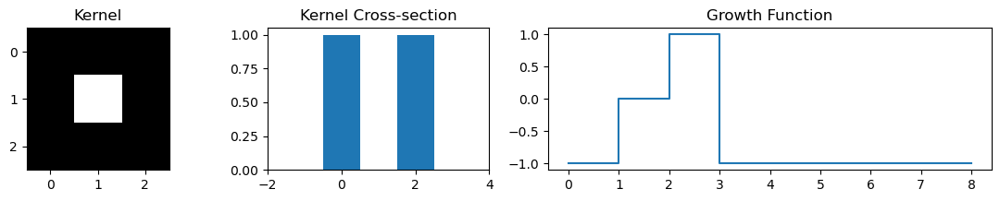

In [4]:
Conway_Game_of_Life = Simulator(cells=Cells(seed=0).cell,kernel=Kernel().square_kernel(3,1),growth_fn=Growth_fn.growth_conway,type='conway_convolve',title=None,demo=False, dT=1, cmap='binary')
Conway_Game_of_Life.plot_kernel_info(cmap='binary', bar=True) # save these two lines to plot kernel information
# Conway_Game_of_Life.animate(frames=300)
# Conway_Game_of_Life.save_animation('Conway_convolve.mp4')
# show_videofile('./demo/Conway_convolve.mp4')

f = np.load('./generation_data/conway_convolve.npz') # Directly use generated data from previous simulation
def update(i):
    img.set_array(f['generation_'+str(i+1)])
    return img,
fig = figure_world(f['generation_0'], titles='Conway Game of life', cmap='gray')
HTML(matplotlib.animation.FuncAnimation(fig, update, frames=50, interval=50).to_jshtml())

## 1.2 Welcome to Lenia

Now we will introduce lenia. To make continuous states, we normalised the cell value between [0, 1] to make generalisation easier. And between each update we define update frequency 1/T compared to the previous discrete case (T=1). The behavior of the system is initiated by the field $\mathbf{A}^0$. Similarly as above, lenia has kernel $\mathbf{K}$ with radius (R), but the kernel shape is dependent on the creature and it can take various forms. Various kernel shape is given in the figure below:

(a) kernel core using exponential function, and 

(b) kernel shell with peaks at (1,$\frac{2}{3}$,$\frac{1}{3}$ ) using exponential. 

(c) rectangular core function. 

(d) kernel shell.

(e) shell displayed in the grid, showing the “influence”(convolution weight) of the site on its neighborhood (darker = larger weight, more influence). 

(f-g) Growth mapping.

Most of the case we can generate it using a smooth bell-shaped function (here Gaussian function). First define a distance array from the center, normalized by factor 1/R, then feed it to the bell-shaped function. The result is a smooth ring-shaped kernel as (d) to preserve spherical symmetry.

![image info](./assets/figs/shell.png)

Above image from Bert Chan's original paper[1]. Then we get the field $\mathbf{U}^t=\mathbf{K}*\mathbf{A}^t$, referred to as the *potential distribution* . One last thing to change when moving in the continuous domain is the growth function $\mathbf{G}$, the scalar *growth mapping*. And $\mathbf{G}^t=G \big(\mathbf{U}^t\big)$ is called the *growth distribution*. Like in GoL, we approximate $G$ as a single gaussian peak that "selects" soft range of $\mathbf{U}^t$ values where growth is happening and it had values in $[-1,1]$ range.

$$G(u) = 2 * \exp\big({-(u-\mu_G)^2 \big/ 2\sigma_G^2}\big) - 1$$

It is again a smooth bell-shaped function, with parameters growth center ($\mu_G$) and growth width ($\sigma_G$)

To sum it all up, lenia can be describe by the local rule:

$$A^{t+\Delta t} = \left[
 A^{t} + \Delta t \;G \big(K*A^t\big)
 \right]_0^1$$

We can see the scalar field $\mathbf{A}$ basically takes the form of PDE system and this will matter a lot later.

## 1.3 The *Orbium*



We will list the update flow here in words:
```
Initialze the value of each cell in the 2-dimensional cell A0 wth value between 0 and 1

calculate convolution with A using kernel K

apply growth mapping G [0,1] -> [-1,1] to K*A

increment with update frequency 1/T

clip the cell value between 0 and 1
```


![image info](./assets/figs/flow.png)

Next we demonstrate the formulation with an iconic example, *Orbium*.

(The function lenia_origin_diagram has several parameter to play with, such as the inital size of the world or the position of the creature. It can be found
 in the utils/lenia.py file)

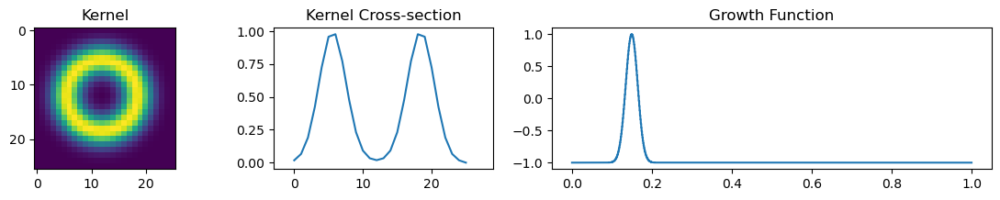

In [5]:
# uncomment to show original simulation video
# lenia_origin_diagram(orbium_params, 
#                      "orbium_convolve", 
#                      Kernel().smooth_ring_kernel(orbium_params.R, orbium_params.R), 
#                      plot_kernel=True)

# direct extraction from the npz file does not speed up the process much in this case
lenia_origin_diagram(orbium_params, 
                     "orbium_convolve", 
                     Kernel().smooth_ring_kernel(orbium_params.R, orbium_params.R), 
                     plot_kernel=True,
                     demo=True)
# f = np.load('./generation_data/orbium_convolve_size_64.npz')
# def update(i):
#     img.set_array(f['generation_'+str(i+1)])
#     return img,
# fig = figure_world(f['generation_0'], titles='Orbium with Convolution', cmap='viridis')
# HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=30).to_jshtml())

# we can also directly show it from demo folder
show_videofile('./demo/orbium_convolve_size_64.mp4')

With the plots generated we can see a concrete example of bell shaped kernel shell as well as the growth potential.

## 1.4 Welcome to Extended Lenia

### Fast Fourier transform

The lenia model can be extended through various enhancements.

Previously we have used pure convolution (scipy.signal.convolve2d) to get $\mathbf{U}^t$:

```
Precompute the kernel function
Put that into a matrix
For every element on the grid:
    Lay that matrix on the grid
    Piecewise multiply each element with the kernel shell
    Add up the products
    Use that for the potential distribution of the neighbor area
    Move to the next element on the grid and continue...
```

Although kernel convolution is very important for signal processing, it is really slow. For an n·n grid size of creature, we need an n·n kernel. Then for every element in the grid (n·n elements), we have to do n·n multiplications for a total of n^4 operations which in the language of computation complexity is $\mathbf{O}(n^4)$.

However, we can reduce the computation power with Fast Fourier transformation. If we denote the Fourier transform as $\mathbf{F}(x)$ and the inverse transform $\mathbf{F}^{-1}(x)$, we
can write convolution as

$$\mathbf{K}*\mathbf{A}^t == \mathbf{F}^{-1}(\mathbf{F}(K) · \mathbf{F}(A^t))$$


The FFT of an n·n grid can be done in $\mathbf{O}(n^2 · log(n))$ operations which gives us the overall bound for convolution which is much better than the $\mathbf{O}(n^4)$ of before.

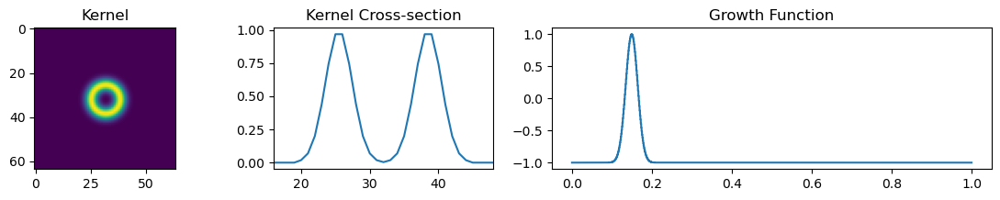

In [2]:
# lenia_origin_diagram(orbium_params, 
#                     "orbium_fft", 
#                     Kernel().smooth_ring_kernel(orbium_params.size//2, orbium_params.R), 
#                     plot_kernel=True)

lenia_origin_diagram(orbium_params, 
                     "orbium_fft", 
                     Kernel().smooth_ring_kernel(orbium_params.size//2, orbium_params.R), 
                     plot_kernel=True,
                     demo=True)
# f = np.load('./generation_data/orbium_fft_size_64.npz')
# def update(i):
#     img.set_array(f['generation_'+str(i+1)])
#     return img,
# fig = figure_world(f['generation_0'], titles='Orbium with FFT', cmap='viridis')
# HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=30).to_jshtml())
show_videofile('./demo/orbium_fft_size_64.mp4')

Note above the kernel shell plot has been zoomed out over the whole world size (64x64) so it looks smaller than the previously zoomed-in version.

The growth field mapping is the same, not affected by the FFT.

We have gathered data on the execution time of two different algorithms across various grid sizes. The plot below illustrates the results, and the experiment was repeated five times to obtain the average execution time and errors. It is evident that, for the most part, the fluctuations are small (except for the FFT size of 128, which exhibits the highest instability). This could be attributed to the fact that the creature type remains the same, resulting in a relatively small error due to the restricted variation imposed by the initial cell condition. Overall, there is not a significant difference in computation power observed for smaller world sizes such as 64x64. However, as the size increases up to 256x256, we can observe that the computation time for convolution grows faster compared to the FFT approach.

Here for the plots I explicitly delete the code to store the calculated mean to reduce the notebook size, but the part to plot graph is given below.

In [7]:
# # plot the execution time of different convolution algorithm
# # choose every 10th elements to make the error more obvious
# plt.errorbar(np.arange(0,len(convolution64_mean))[::10], convolution64_mean[::10], convolution64_std[::10], label="convolution orbium 64")
# plt.errorbar(np.arange(0,len(convolution128_mean))[::10], convolution128_mean[::10], convolution64_std[::10], label="convolution orbium 128")
# plt.errorbar(np.arange(0,len(convolution256_mean))[::10], convolution256_mean[::10], convolution64_std[::10], label="convolution orbium 256")
# plt.errorbar(np.arange(0,len(fft64_mean))[::10], fft64_mean[::10], fft64_std[::10], label="fft orbium 64")
# plt.errorbar(np.arange(0,len(fft128_mean))[::10], fft128_mean[::10], fft128_std[::10], label="fft orbium 128")
# plt.errorbar(np.arange(0,len(fft256_mean))[::10], fft256_mean[::10], fft256_std[::10], label="fft orbium 256")

# plt.title('Comparison of execution time between FFT and scipy.convolve2d with Orbium')
# plt.ylabel('Accumulated Time (s)')
# plt.xlabel('Iterations')
# plt.legend()
# plt.show()

![image info](./demo/fft_comparison.png)

However, one might ponder if there are other ways to enhance the speed. Typically, programs are executed using the CPU. Nevertheless, the fundamental distinction between a CPU and GPU lies in their respective roles: a CPU handles the main functions of a computer, while a GPU is a specialized component adept at concurrently executing numerous smaller tasks. This implies that leveraging the computational power of a GPU for FFT calculations could be a favorable option, particularly for larger grid sizes. Consequently, we have opted to utilize [*Reikna*](https://reikna.publicfields.net/en/latest/api/computations.html) with PyOpenCL as the GPU library, running on the Intel UHD Graphics 630 hardware of my Mac. Furthermore, it is worth noting that different Python packages employ distinct algorithms. Thus, we have chosen scipy's FFT function, along with [*pyFFTW*](https://pyfftw.readthedocs.io/en/latest/) integrated with spicy, for our experiments. It is important to mention that pyFFTW serves as a Pythonic wrapper for FFTW, which aims to accelerate the computation process

Note: because file name for this part is not as systematic as other parts. So we will enter the name manually.

In [8]:
# generations = len(t_fft_64_mean)
# # plot 4x4 subplots
# fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 10))
# fig.suptitle('Computation time Comparison of Orbium', size=20)

# ax1.errorbar(np.arange(0,generations)[::10], t_fft_64_mean[::10], t_fft_64_std[::10], label='fft64')
# ax1.errorbar(np.arange(0,generations)[::10], t_fft_128_mean[::10], t_fft_128_std[::10], label='fft128')
# ax1.errorbar(np.arange(0,generations)[::10], t_fft_256_mean[::10], t_fft_256_std[::10], label='fft256')

# ax2.errorbar(np.arange(0,generations)[::10], t_scipy_64_mean[::10], t_scipy_64_std[::10], label='scipy64')
# ax2.errorbar(np.arange(0,generations)[::10], t_scipy_128_mean[::10], t_scipy_128_std[::10], label='scipy128')
# ax2.errorbar(np.arange(0,generations)[::10], t_scipy_256_mean[::10], t_scipy_256_std[::10], label='scipy256')

# ax3.errorbar(np.arange(0,generations)[::10], t_gpu_64_mean[::10], t_gpu_64_std[::10], label='gpu64')
# ax3.errorbar(np.arange(0,generations)[::10], t_gpu_128_mean[::10], t_gpu_128_std[::10], label='gpu128')
# ax3.errorbar(np.arange(0,generations)[::10], t_gpu_256_mean[::10], t_gpu_256_std[::10], label='gpu256')

# ax4.errorbar(np.arange(0,generations)[::10], t_pyfftw_64_mean[::10], t_pyfftw_64_std[::10], label='pyfftw64')
# ax4.errorbar(np.arange(0,generations)[::10], t_pyfftw_128_mean[::10], t_pyfftw_128_std[::10], label='pyfftw128')
# ax4.errorbar(np.arange(0,generations)[::10], t_pyfftw_256_mean[::10], t_pyfftw_256_std[::10], label='pyfftw256')

# # label each plot with title
# titles = ['FFT with Numpy', 'FFT with Reikna GPU', 'FFT with Scipy', 'FFT with pyFFTW interfaced with scipy']
# end_point = np.array([t_fft_256_mean[-1], t_gpu_256_mean[-1], t_scipy_256_mean[-1], t_pyfftw_256_mean[-1]])
# for i,ax in enumerate(fig.get_axes()):
#     ax.legend()
#     ax.title.set_text(titles[i])
#     ax.set_xlabel('Iteration')
#     ax.set_ylabel('Accumulated time (s)')
#     # mark the end point for the largest cell
#     ax.annotate('%0.2f' % end_point[i], xy=(1, end_point[i]), xytext=(8, 0), 
#                  xycoords=('axes fraction', 'data'), textcoords='offset points')
#     # ax.set_ylim([-0.5,2])
#     ax.set_xlim([-1,300])

![image info](./demo/4_panel_output.png)

At the conclusion of each iteration for the different methods, we recorded the final execution times for the 256-grid size. The results reveal that FFT with numpy actually performs the poorest among the solutions, although the difference is not significant when considering the overall timescale. It is reasonable to expect that both the GPU and the Python wrapper would reduce the calculation time to some extent. However, at least for grid sizes up to 256x256, the difference is not very noticeable. This can be attributed to the fact that the total execution time for the 256x256 cell grids is only around 3 minutes, which is not substantial for a general computation task. As a result, the advantages of the GPU and the FFT wrapper have not had a significant opportunity to manifest. However, further investigation is not warranted since a grid size of 256x256 is more than sufficient for the Lenia simulation.

### Multiple ring kernel

Next we move on to explore more complicated creatures. What if we add in another ring of kernel? Below we illustrate with an example called Geminium, which has the kernel of multiple rings, with new parameter kernel peaks (b or &beta;). We can see with similar growth mapping, even though the kernel shell is different the motion of the creature is still more or less the same.

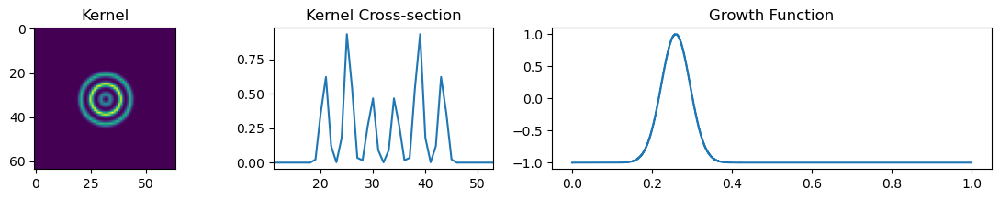

In [3]:
# lenia_origin_diagram(geminium_params, 
#                      "geminium_fft", 
#                      Kernel().kernel_shell(
#                      geminium_params.size//2,
#                      geminium_params.R*0.75, 
#                      np.asarray(geminium_params.b)), 
#                      plot_kernel=True,
#                      cx=10,cy=10, scale=0.75)

lenia_origin_diagram(geminium_params, 
                     "geminium_fft", 
                     Kernel().kernel_shell(geminium_params.size//2, geminium_params.R*0.75, np.asarray(geminium_params.b)), 
                     plot_kernel=True,
                     demo=True,cx=10,cy=10,scale=0.75)
# f = np.load('./generation_data/geminium_fft_size_64.npz')
# def update(i):
#     img.set_array(f['generation_'+str(i+1)])
#     return img,
# fig = figure_world(f['generation_0'], titles='Geminium with FFT', cmap='viridis')
# HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=30).to_jshtml())
show_videofile('./demo/geminium_fft_size_64.mp4')

### Multiple kernels

Although sometimes different kernel in one world would lead to chaotic systems. With right parameter ,especially in the initial condition, lenia can demonstrate high degree of self-organization. We multiply the original rule with multiple kernels Ks, each with relative radius $R_k$, and corresponding growth mapping $G_k$. Weighted average of the results by
factors $\frac{h_k}{h}$ (h is the sum of $h_k$) is taken. The number of kernels is denoted as nk.
To represent it in he list comprehension syntax of Python: (e.g. ```Us = [ ... for K in Ks ]```). A fish-like creature is loaded. This is very useful in real cell modelling, such as bacteria. Becasue in reality lifeform does not always go straight ahead.

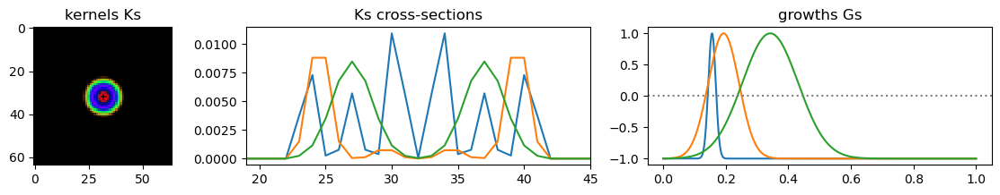

In [4]:
lenia_extended_diagram('fish_scipy', fish, SIZE=1<<6, plot_kernel=True, demo=True, show_on_finish=False) # change demo to False to show original simulation

# f = np.load('./generation_data/fish_scipy_size_64.npz')
# def update(i):
#     img.set_array(f['generation_'+str(i+1)])
#     return img,
# fig = figure_world(f['generation_0'], titles='Fish with FFT', cmap='viridis')
# HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=30).to_jshtml())
show_videofile('./demo/fish_fft_size_64.mp4')

### Multiple channels

Finally, to make it more interesting, we can add in different channels for the creature. In a multi-channel world, each channel
develops patterns according to its own rule, and at the same
time, these patterns co-develop and influence each other
through channel-channel interactions. Different channels of
a soliton could exhibit something like a division of labor, which makes it very useful to simulate multicellular organisms.

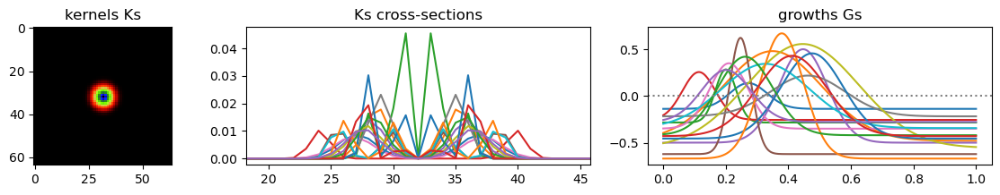

In [5]:
lenia_multi_channel_diagram('aquarium_fft', aquarium, SIZE=1<<6, plot_kernel=True, cx=20, cy=20, scale=0.9, demo=True, show_on_finish=False) # change demo to False to show original simulation

# f = np.load('./generation_data/aquarium_fft_size_64.npz')
# def update(i):
#     img.set_array(np.dstack(f['generation_'+str(i+1)]))
#     return img,
# fig = figure_world(np.dstack(f['generation_0']), titles='Aquarium with FFT', cmap='viridis')
# HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=30).to_jshtml())
show_videofile('./demo/aquarium_fft_size_64.mp4')

### Compare in Bar Chart

We put the data in a 3D bar chart. First we need to creature a dictionary for reference 


In [6]:
# search all the npy file in format of execution time and find the total accumulated time
bars = dict()
path = os.path.join(os.getcwd(), 'exec_time')
for filename in glob.glob(os.path.join(path, '*.npy')):
    tmp = filename.split('/')[-1].split('.')[0].split('_')
    if len(tmp) == 4 and tmp[0] != 'conway' and not tmp[0].startswith('Q'):
        f = np.load(filename)
        if tmp[1] == 'fft':
            bars['_'.join(tmp)] = f[-1] - f[0]
        else:
            bars['_'.join(tmp)] = f[-1] - f[0]

In [7]:
# put lenia types in different categories to make better visualisation
# add extra space for bar chart tick padding
Single_Kernel_creature = ['orbium', '             Aerogeminiumimmotus', ' .   Scutiumsolidus', '            Circoechiniumventilans']
# multi parameters include both multiple kernels and channels. add orbium for comparison
Multi_Parameters_creature = ['orbium', 'fish', '           Vagopteronvagus', 'aquarium']

In [8]:
# check dictionary values
print(bars)

{'orbium_gpu_size_64': 14.251748793001752, 'orbium_fft_size2_128': 43.44890696101356, 'orbium_convolve_size3_256': 207.78741309104953, 'orbium_scipy_size_64': 15.452420915011317, 'pacmanSoft_fft_size_64': 11.893630811013281, 'orbium_scipy_1size_256': 203.4132724100491, 'orbium_fft_4size_128': 43.916455507976934, 'fish_scipy_size_64': 17.67143730202224, 'orbium_fft_3size_64': 12.385093895019963, 'orbium_gpu_4size_128': 40.42709797003772, 'Vagopteronvagus_fft_size_64': 13.98660744301742, 'orbium_scipy_3size_128': 44.42346402897965, 'orbium_gpu_3size_64': 11.814793411060236, 'orbium_scipy_size_256': 179.64108214899898, 'orbium_fft_1size_128': 44.88782198203262, 'orbium_gpu_3size_256': 172.10072765289806, 'orbium_scipy_4size_256': 187.24174016795587, 'Circoechiniumventilans_scipy_size_128': 50.12666290998459, 'Scutiumsolidus_fft_size_128': 48.39964544697432, 'orbium_gpu_1size_128': 47.27186166099273, 'Circoechiniumventilans_scipy_size_64': 14.143283629964571, 'orbium_fft_3size_256': 187.01

At the end of the next cell, there is an option of choosing the view angle to adjust the bar chart orientation.

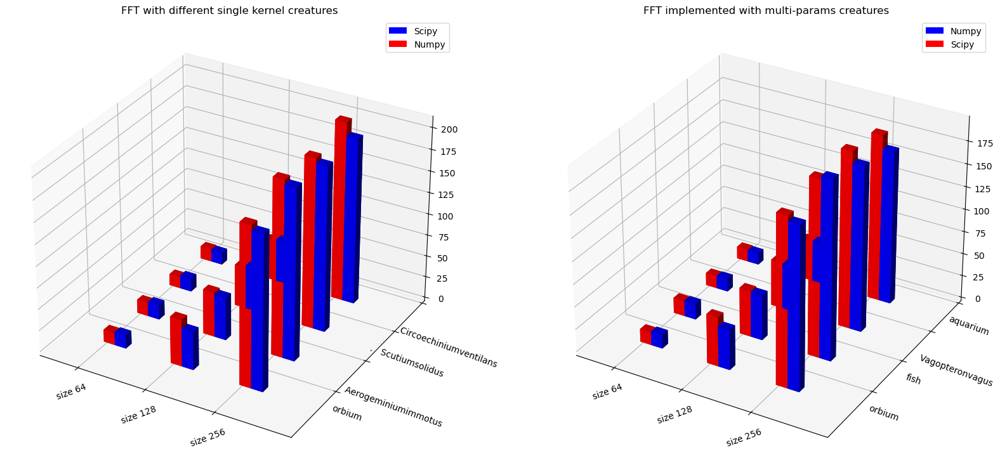

In [9]:
# set up the figure and axes
fig = plt.figure(figsize=(20, 10))
ax1 = fig.add_subplot(121, projection='3d')
ax2 = fig.add_subplot(122, projection='3d')

# y is creature type
# x is size of array
# z is the computation time
_x1 = np.arange(3, 18, 6)
_y = np.arange(4, 24, 6)
_xx1, _yy = np.meshgrid(_x1, _y)
x1, y = _xx1.ravel(), _yy.ravel()
_x2= np.arange(4, 19, 6)
_xx2, _yy = np.meshgrid(_x2, _y)
x2 = _xx2.ravel()
# extract execution time
top_single_numpy = [bars['orbium_fft_size_64'],bars['orbium_fft_size_128'],bars['orbium_fft_size_256'],bars['Aerogeminiumimmotus_fft_size_64'],bars['Aerogeminiumimmotus_fft_size_128'],bars['Aerogeminiumimmotus_fft_size_256'],
                    bars['Scutiumsolidus_fft_size_64'],bars['Scutiumsolidus_fft_size_128'],bars['Scutiumsolidus_fft_size_256'],bars['Circoechiniumventilans_fft_size_64'],bars['Circoechiniumventilans_fft_size_128'],bars['Circoechiniumventilans_fft_size_256']]
top_single_scipy = [bars['orbium_scipy_size_64'],bars['orbium_scipy_size_128'],bars['orbium_scipy_size_256'],bars['Aerogeminiumimmotus_scipy_size_64'],bars['Aerogeminiumimmotus_scipy_size_128'],bars['Aerogeminiumimmotus_scipy_size_256'],
                    bars['Scutiumsolidus_scipy_size_64'],bars['Scutiumsolidus_scipy_size_128'],bars['Scutiumsolidus_scipy_size_256'],bars['Circoechiniumventilans_scipy_size_64'],bars['Circoechiniumventilans_scipy_size_128'],bars['Circoechiniumventilans_scipy_size_256']]
top_multi_numpy = [bars['orbium_fft_size_64'],bars['orbium_fft_size_128'],bars['orbium_fft_size_256'],bars['fish_fft_size_64'],bars['fish_fft_size_128'],bars['fish_fft_size_256'],
                    bars['Vagopteronvagus_fft_size_64'],bars['Vagopteronvagus_fft_size_128'],bars['Vagopteronvagus_fft_size_256'],bars['aquarium_fft_size_64'],bars['aquarium_fft_size_128'],bars['aquarium_fft_size_256']]
top_multi_scipy = [bars['orbium_scipy_size_64'],bars['orbium_scipy_size_128'],bars['orbium_scipy_size_256'],bars['fish_scipy_size_64'],bars['fish_scipy_size_128'],bars['fish_scipy_size_256'],
                    bars['Vagopteronvagus_scipy_size_64'],bars['Vagopteronvagus_scipy_size_128'],bars['Vagopteronvagus_scipy_size_256'],bars['aquarium_scipy_size_64'],bars['aquarium_scipy_size_128'],bars['aquarium_scipy_size_256']]

bottom = np.zeros_like(top_single_numpy)
width = 1
depth = 1

colors = ['red', 'blue']
ax1.bar3d(x1, y, bottom, width, depth, top_single_numpy, shade=True, color=colors[0], zsort='average')
red_proxy = plt.Rectangle((0, 0), 1, 1, fc="r")
ax1.bar3d(x2, y, bottom, width, depth, top_single_scipy, shade=True, color=colors[1], zsort='average')
blue_proxy = plt.Rectangle((0, 0), 1, 1, fc="b")
ax1.legend([blue_proxy,red_proxy],['Scipy','Numpy'])
ax1.set_title('FFT with different single kernel creatures')
ax1.set_xticks(np.arange(3, 18, 6), ['size 64', 'size 128', 'size 256'],
        rotation=20)
ax1.set_xlim([0,21])
ax1.set_yticks(np.arange(8, 30, 6), Single_Kernel_creature, size=10,
        rotation=-20)
ax1.set_ylim([0,26])

ax2.bar3d(x1, y, bottom, width, depth, top_multi_numpy, shade=True, color=colors[0], zsort='average')
red_proxy = plt.Rectangle((0, 0), 1, 1, fc="r")
ax2.bar3d(x2, y, bottom, width, depth, top_multi_scipy, shade=True, color=colors[1], zsort='average')
blue_proxy = plt.Rectangle((0, 0), 1, 1, fc="b")
ax2.legend([blue_proxy,red_proxy],['Numpy','Scipy'])
ax2.set_title('FFT implemented with multi-params creatures')
ax2.set_xticks(np.arange(3, 18, 6), ['size 64', 'size 128', 'size 256'],
        rotation=20)
ax2.set_xlim([0,21])
ax2.set_yticks(np.arange(8, 30, 6), Multi_Parameters_creature, size=10,
        rotation=-20)
ax2.set_ylim([0,26])
# plt.savefig(
#     'main_{}_{}_{}.png'.format(ax.azim, ax.dist, ax.elev),
#     format='png',
#     bbox_inches='tight'
# )
plt.show()

It is clear to see that execution time increases significantly as the size grows. And most of the case, scipy performs better than numpy except at size 256 of fish, where numpy is slightly better.

## 1.5 Lenia Variants

### Asymptotic update

Another set of update rule comes from [*asymptotic Lenia*[6]](https://direct.mit.edu/isal/proceedings/isal/33/91/102916). Basically the
proposed model uses a target function T in place of the growth
function G, in which T is defined as (G + 1) / 2 so that the states
stay within the unit range [0, 1]. Each state value is increased
or decreased to reduce the distance from the target value in the
next step. If we take the totalistic sum in GoL as not growth
ability but survivability of the cell, we can consider this
replacement more closely follows the idea of GoL as this model
interprets the calculated convolution value as not an increase in
the current state value but a target value.

So we need to update with the following equation

$$A^{t+\Delta t} = 
 A^{t} + \Delta t 
 ( T\big(K*A^t\big) - A^{t} )
$$

Differential form:

$$ \partial _t A = T\big(K*A\big) - A $$

Load the [*smooth glider gun*](https://twitter.com/BertChakovsky/status/1325458229778771969?s=20) pattern, it uses asymptotic update (target function) in the blue channel.

In [10]:
# lenia_multi_channel_diagram('emitter_fft', emitter, SIZE=1<<8, plot_kernel=True, cx=80, cy=80, scale=3)

f = np.load('./generation_data/emitter_fft_size_256.npz')
def update(i):
    img.set_array(np.dstack(f['generation_'+str(i+1)]))
    return img,
# fig = figure_world(np.dstack(f['generation_0']), titles='Emitter with FFT', cmap='viridis')
# HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=30).to_jshtml())
show_videofile('./demo/emitter_fft.mp4')

This is basically a [*integro-differential equation*](https://en.wikipedia.org/wiki/Integro-differential_equation). Different [*approach*](https://idesolver.readthedocs.io/en/latest/) can be utilized to make computation easier. But one thing interesting to notice is that the form of target functions looks very like an operator action, which is related what we want to do with semi-quantum lenia.

### Soft clip

Previously we have a square (discrete) clipper function from dumpy. But to make it more realistic and physical, we can also approximate the function with a smooth clipping, just like the growth function. Here we've plotted the soft clip function of form:

$$ C_p = \frac{1}{1 + e^{-4 * (x - 0.5)}} $$

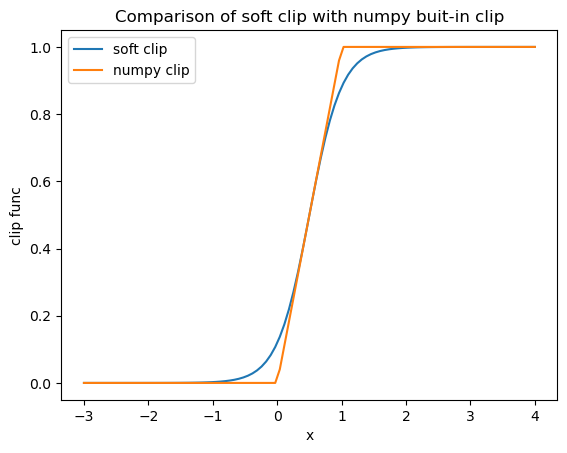

In [24]:
x = np.linspace(-3,4,100)
plt.plot(x,sc(x,vmin=0,vmax=1), label='soft clip')
plt.plot(x,np.clip(x,0,1), label='numpy clip')
plt.title('Comparison of soft clip with numpy buit-in clip')
plt.xlabel('x')
plt.ylabel('clip func')
plt.legend()
plt.show()

Change the hard clip function to soft clip (sigmoid) function. The patterns become smoother and exhibit long-range sensing. Load a [*pacman-like pattern*](https://twitter.com/BertChakovsky/status/1371828031497531399?s=20) and compare it in a panel.

In [24]:
# lenia_multi_channel_diagram('pacmanSoft_fft', pacman, SIZE=1<<6, plot_kernel=False, cx=5, cy=5, scale=1.2, clip='soft_clip',show_on_finish=False)
# lenia_multi_channel_diagram('pacman_fft', pacman, SIZE=1<<6, plot_kernel=False, cx=5, cy=5, scale=1.2,show_on_finish=False)
# lenia_multi_channel_diagram('pacmanSoft_scipy', pacman, SIZE=1<<6, plot_kernel=False, cx=5, cy=5, scale=1.2, clip='soft_clip',show_on_finish=False)
# lenia_multi_channel_diagram('pacman_scipy', pacman, SIZE=1<<6, plot_kernel=False, cx=5, cy=5, scale=1.2,show_on_finish=False)
soft_clip = np.load('./generation_data/pacmanSoft_fft_size_64.npz') 
np_clip = np.load('./generation_data/pacman_fft_size_64.npz') 
soft_clip_s = np.load('./generation_data/pacmanSoft_scipy_size_64.npz') 
np_clip_s = np.load('./generation_data/pacman_scipy_size_64.npz') 
def figure_panels(soft_clip,np_clip,soft_clip_s,np_clip_s, cmap='viridis'):
  global img1, img2, img3, img4
  fig = plt.figure(figsize=(8,8), dpi=75, frameon=False)
  plt.subplot(221).set_axis_off();  img1 = plt.imshow(np.dstack(soft_clip['generation_0']), vmin=0)
  plt.subplot(222).set_axis_off();  img2 = plt.imshow(np.dstack(np_clip['generation_0']), vmin=0)
  plt.subplot(223).set_axis_off();  img3 = plt.imshow(np.dstack(soft_clip_s['generation_0']), vmin=0)
  plt.subplot(224).set_axis_off();  img4 = plt.imshow(np.dstack(np_clip_s['generation_0']), vmin=0)
  plt.close()
  return fig

def update(i):
  global soft_clip,np_clip,soft_clip_s,np_clip_s, img # global img initiated in the previous cell
  ''' update panels '''
  img1.set_array(np.dstack(soft_clip['generation_'+str(i+1)]))
  img2.set_array(np.dstack(np_clip['generation_'+str(i+1)]))
  img3.set_array(np.dstack(soft_clip_s['generation_'+str(i+1)]))
  img4.set_array(np.dstack(np_clip_s['generation_'+str(i+1)]))
  return img,
fig = figure_panels(soft_clip,np_clip,soft_clip_s,np_clip_s)
HTML(matplotlib.animation.FuncAnimation(fig, update, frames=300, interval=40).to_jshtml())

    Top left: Pacman soft clip with Numpy FFT

    Top right: Pacman numpy clip with Numpy FFT

    Bottom left: Pacman soft clip with Scipy FFT

    Bottom right: Pacman numpy clip with Scipy FFT

We can see from above that with softclip the behaviour of the pacman indeed exhibit long range sensing and is to some extent, smoother.